# Импорт SCHN датасета и необходимых бибилотек

In [ ]:
!wget http://ufldl.stanford.edu/housenumbers/train.tar.gz
!tar -xf train.tar.gz
!rm /content/train.tar.gz

--2024-11-15 10:17:46--  http://ufldl.stanford.edu/housenumbers/train.tar.gz
Resolving ufldl.stanford.edu (ufldl.stanford.edu)... 171.64.68.10
Connecting to ufldl.stanford.edu (ufldl.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 404141560 (385M) [application/x-gzip]
Saving to: ‘train.tar.gz’

train.tar.gz        100%[===================>] 385.42M  18.2MB/s    in 38s     

2024-11-15 10:18:24 (10.2 MB/s) - ‘train.tar.gz’ saved [404141560/404141560]



In [ ]:
!wget http://ufldl.stanford.edu/housenumbers/test.tar.gz
!tar -xf test.tar.gz
!rm /content/test.tar.gz

--2024-11-15 10:18:53--  http://ufldl.stanford.edu/housenumbers/test.tar.gz
Resolving ufldl.stanford.edu (ufldl.stanford.edu)... 171.64.68.10
Connecting to ufldl.stanford.edu (ufldl.stanford.edu)|171.64.68.10|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 276555967 (264M) [application/x-gzip]
Saving to: ‘test.tar.gz’

test.tar.gz         100%[===================>] 263.74M  12.4MB/s    in 30s     

2024-11-15 10:19:23 (8.93 MB/s) - ‘test.tar.gz’ saved [276555967/276555967]



In [ ]:
import h5py
import json
import numpy as np

def get_name(f, idx=0):
    """
    Извлекает название изображения из HDF5.

    Args:
    f (h5py.File): открытый HDF5-файл
    idx (int): индекс изображения в датасете.

    Returns:
    str: название изображения.
    """
    name_ref = f['digitStruct']['name'][idx].item()
    return ''.join(chr(c[0]) for c in f[name_ref])

def get_bbox(f, idx=0):
    """
    Извлекает информацию о bounding box для изображения.

    Args:
    f (h5py.File): открытый HDF5-файл
    idx (int): индекс изображения в датасете.

    Returns:
    list: Список словарей, каждый из которых содержит информацию об ограничивающей рамке для определенной цифры.
    """
    bbox_ref = f['digitStruct']['bbox'][idx].item()
    bbox_item = f[bbox_ref]

    # Получаем количество ограничивающих рамок для этого изображения
    n_boxes = bbox_item['label'].shape[0]

    bbox_list = []
    for i in range(n_boxes):
        bbox = {}
        for key in ['label', 'left', 'top', 'width', 'height']:
            attr = bbox_item[key]
            if attr.shape[0] == 1:
                value = attr[0][0]
            else:
                value = f[attr[i][0]][()].item()
            bbox[key] = value
        bbox_list.append(bbox)

    return bbox_list

def mat_to_json(mat_file, json_file):
    """
    Конвертация digitStruct.mat ==> формат JSON .

    Args:
    mat_file (str): путь к входному файлу .mat
    json_file (str): путь к выходному файлу .json
    """
    with h5py.File(mat_file, 'r') as f:
        data = []
        # Выполняет итератор по всем записям в файле .mat
        for i in range(len(f['digitStruct']['name'])):
            item = {
                'filename': get_name(f, i),
                'boxes': get_bbox(f, i)
            }
            data.append(item)

    # запись извлеченных файлов в файл JSON
    with open(json_file, 'w') as f:
        json.dump(data, f, indent=2)



In [ ]:
from PIL import Image
import matplotlib.pyplot as plt


In [ ]:
# to train
mat_to_json('/content/train/digitStruct.mat', 'train_digitStruct.json')

In [ ]:
# to test
mat_to_json('/content/test/digitStruct.mat', 'test_digitStruct.json')

In [ ]:
def load_data(json_file):
    if json_file.startswith("train"):
        base_path = '/content/train/'
    elif json_file.startswith("test"):
        base_path = '/content/test/'
    else:
        raise ValueError("Название файла должно начинаться с 'train' или 'test'")

    with open(json_file, 'r') as f:
        data = json.load(f)

    images = []
    labels = []

    for item in data:
        img_path = base_path + item['filename']
        img = Image.open(img_path).convert('RGB')
        img = img.resize((32, 32))
        images.append(np.array(img))

        label_str = ''.join([str(box['label']) for box in item['boxes']])
        labels.append(label_str)


    return np.array(images), np.array(labels)

- Теперь у нас есть 2 json файла, в которых название картинок и соответсвующие ббоксы с лейблом и координатами

# Подготовка базы для модели YOLO

- создадим папки с изображениями и разметками YOLO

In [ ]:
train_json_path = '/content/train_digitStruct.json'
test_json_path = '/content/train_digitStruct.json'
# Папка с изображениями
images_dir = '/content/images'
# Папка для аннотаций YOLO
labels_dir = '/content/labels'

In [ ]:
def convert_bbox(size, box):
    dw = 1. / size[0]
    dh = 1. / size[1]
    x_center = (box['left'] + box['width'] / 2.0) * dw
    y_center = (box['top'] + box['height'] / 2.0) * dh
    width = box['width'] * dw
    height = box['height'] * dh
    return (x_center, y_center, width, height)

- Конвертер нужен, тк в json написаны параметры верхней левой вершины ббокса, его ширина и высота. Yolo разметка в формате X_center, y_center, w, h

In [ ]:
with open(train_json_path) as f:
    train_data = json.load(f)

In [ ]:

import os

- В следующей ячейке создадим YOLO разметки для train  и test. Обратим внимание, что в исходном датасете labels = [1, 2, ... 10], где лейбл 10 - это цирфа 0. Сразу зададим цифре 0 - лейбл 0. В torchvision.datasets.SVHN такое преобразование сделано автоматически

In [ ]:
for item in train_data:
    filename = item['filename']
    image_path = os.path.join(images_dir, 'train', filename)

    # Получаем размер изображения
    if not os.path.exists(image_path):
        print(f"Image {image_path} not found.")
        continue

    # Открытие изображения для получения его размеров
    from PIL import Image
    with Image.open(image_path) as img:
        width, height = img.size

    # Создание YOLO файла для аннотаций
    yolo_annotation = []
    for box in item['boxes']:
        if int(box['label']) == 10:
          label = 0
        else:
          label = int(box['label'])  # Класс объекта
        bbox = convert_bbox((width, height), box)
        yolo_annotation.append(f"{label} {bbox[0]} {bbox[1]} {bbox[2]} {bbox[3]}")

    # Сохранение аннотации в текстовый файл
    label_path = os.path.join(labels_dir, 'train', f"{os.path.splitext(filename)[0]}.txt")
    with open(label_path, 'w') as f:
        f.write("\n".join(yolo_annotation))

In [ ]:
with open(test_json_path) as f:
    test_data = json.load(f)

In [ ]:
for item in test_data:
    filename = item['filename']
    image_path = os.path.join(images_dir, 'test', filename)

    # Получаем размер изображения
    if not os.path.exists(image_path):
        print(f"Image {image_path} not found.")
        continue

    # Открытие изображения для получения его размеров
    from PIL import Image
    with Image.open(image_path) as img:
        width, height = img.size

    # Создание YOLO файла для аннотаций
    yolo_annotation = []
    for box in item['boxes']:
        if int(box['label']) == 10:
          label = 0
        else:
          label = int(box['label'])  # Класс объекта
        bbox = convert_bbox((width, height), box)
        yolo_annotation.append(f"{label} {bbox[0]} {bbox[1]} {bbox[2]} {bbox[3]}")

    # Сохранение аннотации в текстовый файл
    label_path = os.path.join(labels_dir, 'test', f"{os.path.splitext(filename)[0]}.txt")
    with open(label_path, 'w') as f:
        f.write("\n".join(yolo_annotation))

Выходные данные были обрезаны до нескольких последних строк (5000).
Image /content/images/test/28403.png not found.
Image /content/images/test/28404.png not found.
Image /content/images/test/28405.png not found.
Image /content/images/test/28406.png not found.
Image /content/images/test/28407.png not found.
Image /content/images/test/28408.png not found.
Image /content/images/test/28409.png not found.
Image /content/images/test/28410.png not found.
Image /content/images/test/28411.png not found.
Image /content/images/test/28412.png not found.
Image /content/images/test/28413.png not found.
Image /content/images/test/28414.png not found.
Image /content/images/test/28415.png not found.
Image /content/images/test/28416.png not found.
Image /content/images/test/28417.png not found.
Image /content/images/test/28418.png not found.
Image /content/images/test/28419.png not found.
Image /content/images/test/28420.png not found.
Image /content/images/test/28421.png not found.
Image /content/image

- импортируем в папку val для image, label 500 примеров

In [ ]:
import shutil

In [ ]:
images_train_dir = '/content/images/train'
images_val_dir = '/content/images/val'

In [ ]:
files = sorted(os.listdir(images_train_dir))

# Выбираем последние 50 файлов
files_to_move = files[-500:]

In [ ]:
for file_name in files_to_move:
    src_path = os.path.join(images_train_dir, file_name)
    dst_path = os.path.join(images_val_dir, file_name)
    shutil.move(src_path, dst_path)

In [ ]:
labels_train_dir = '/content/labels/train'
labels_val_dir = '/content/labels/val'

In [ ]:
files = sorted(os.listdir(labels_train_dir))

# Выбираем последние 50 файлов
files_to_move = files[-500:]

In [ ]:
for file_name in files_to_move:
    src_path = os.path.join(labels_train_dir, file_name)
    dst_path = os.path.join(labels_val_dir, file_name)
    shutil.move(src_path, dst_path)

In [ ]:

len(os.listdir('/content/images/train'))

32904

- Создадим dataset.yaml который необходим длоя обучения модели

In [ ]:
import yaml

# Укажите пути к данным
dataset_info = {
    'train': '/content/images/train',
    'val': '/content/images/val',
    'test': '/content/images/test',
    'nc': 10,
    'names': ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']
}

# Создайте файл dataset.yaml
with open("/content/dataset.yaml", 'w') as yaml_file:
    yaml.dump(dataset_info, yaml_file, default_flow_style=False)

print("Файл dataset.yaml создан")

Файл dataset.yaml создан


In [ ]:
!pip install ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 886.3/886.3 kB 37.8 MB/s eta 0:00:00


# Обучениемодели Yolo5nu

-  Обучим модель YOLO5nu детектировать и классифицировать цирфы от 0 до 10

In [ ]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
model = YOLO('yolov5nu.pt')

100%|██████████| 5.31M/5.31M [00:00<00:00, 179MB/s]


In [ ]:
dataset_path = "/content/dataset.yaml"

In [ ]:
results = model.train(data=dataset_path,
                      epochs=3,
                      imgsz=640,
                      project='runs/train',
                      name='yolov5n_exp1',
                      device='0')

Ultralytics 8.3.31 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5nu.pt, data=/content/dataset.yaml, epochs=3, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=runs/train, name=yolov5n_exp1, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_

100%|██████████| 755k/755k [00:00<00:00, 42.7MB/s]


Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1      1760  ultralytics.nn.modules.conv.Conv             [3, 16, 6, 2, 2]              
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      4800  ultralytics.nn.modules.block.C3              [32, 32, 1]                   
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     29184  ultralytics.nn.modules.block.C3              [64, 64, 2]                   
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  3    156928  ultralytics.nn.modules.block.C3              [128, 128, 3]                 
  7                  -1  1    295424  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 184MB/s]


AMP: checks passed ✅


train: Scanning /content/labels/train... 32902 images, 2 backgrounds, 1 corrupt: 100%|██████████| 32904/32904 [00:17<00:00, 1897.80it/s]

train: WARNING ⚠️ /content/images/train/12668.png: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.3077]


train: New cache created: /content/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.21 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/labels/val... 498 images, 0 backgrounds, 0 corrupt: 100%|██████████| 498/498 [00:00<00:00, 1266.67it/s]

val: New cache created: /content/labels/val.cache


Plotting labels to runs/train/yolov5n_exp1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/train/yolov5n_exp1
Starting training for 3 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/3      2.31G        1.7       2.06       1.45         35        640: 100%|██████████| 2057/2057 [10:30<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.58it/s]

                   all        498       1077      0.832      0.763       0.84      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/3      2.27G       1.63        1.3      1.365         36        640: 100%|██████████| 2057/2057 [10:22<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  4.26it/s]

                   all        498       1077       0.85       0.79      0.884      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/3      2.27G      1.604      1.147      1.338         45        640: 100%|██████████| 2057/2057 [10:13<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.34it/s]

                   all        498       1077      0.889      0.822      0.901      0.483



3 epochs completed in 0.524 hours.
Optimizer stripped from runs/train/yolov5n_exp1/weights/last.pt, 5.3MB
Optimizer stripped from runs/train/yolov5n_exp1/weights/best.pt, 5.3MB

Validating runs/train/yolov5n_exp1/weights/best.pt...
Ultralytics 8.3.31 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,504,894 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:03<00:00,  4.06it/s]


                   all        498       1077      0.889      0.821      0.902      0.483
                     0         76         79      0.909      0.762      0.892      0.527
                     1        183        217      0.899      0.739      0.876      0.413
                     2        138        155      0.885      0.892      0.933      0.486
                     3        118        122       0.94      0.907      0.941      0.532
                     4        104        108      0.873      0.861      0.905      0.457
                     5         98        103      0.876      0.777        0.9      0.486
                     6         63         68      0.832      0.794      0.838      0.457
                     7         82         88      0.906      0.769      0.887      0.445
                     8         57         58      0.921      0.828      0.907      0.523
                     9         74         79      0.851      0.886      0.937      0.508
Speed: 0.1ms preproce

- В отчете видим, что на validation модель классифицирует с точностью P: 0.73-0.90 для каждого класса

In [ ]:
import tensorboard.notebook as tb
import tensorflow as tf

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
tb.start('%tensorboard --logdir runs/train/yolov5n_exp1')

ERROR: Failed to launch TensorBoard (exited with 2).
Contents of stderr:
usage: tensorboard [-h] [--helpfull] {serve} ...
tensorboard: error: argument {serve}: invalid choice: '%tensorboard' (choose from 'serve')

In [ ]:
test_img_path = '/content/images/test/1.png'

In [ ]:
test_img_result = model(test_img_path)


image 1/1 /content/images/test/1.png: 320x640 1 5, 15.7ms
Speed: 3.4ms preprocess, 15.7ms inference, 2.1ms postprocess per image at shape (1, 3, 320, 640)


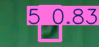

In [ ]:
test_img_result[0].show()

- Сохраним модель в onnx

In [ ]:
model.export(format='onnx')

Ultralytics 8.3.31 🚀 Python-3.10.12 torch-2.5.0+cu121 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/train/yolov5n_exp1/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 14, 8400) (5.0 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 235.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.8/141.8 kB 314.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 291.5/291.5 MB 250.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 216.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 316.0 MB/s eta 0:00:00

requirements: AutoUpdate success ✅ 23.1s, installed 3 packages: ['onnx>=1.12.0', 'onnxslim', 'onnxruntime-gpu']
requirements: ⚠️ Restart runtime or rerun command for updates to take effect


ONNX: starting export with onnx 1.17.0 opset 19...
ONN

'runs/train/yolov5n_exp1/weights/best.onnx'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


- Сделаем предсказания

In [ ]:
predictions_result = model('/content/images/test', save_txt=True, conf=0.25)

Выходные данные были обрезаны до нескольких последних строк (5000).
image 8072/13068 /content/images/test/5500.png: 320x640 2 4s, 8.9ms
image 8073/13068 /content/images/test/5501.png: 320x640 2 2s, 1 4, 11.0ms
image 8074/13068 /content/images/test/5502.png: 256x640 2 1s, 1 7, 10.1ms
image 8075/13068 /content/images/test/5503.png: 288x640 1 0, 1 4, 9.8ms
image 8076/13068 /content/images/test/5504.png: 320x640 (no detections), 7.9ms
image 8077/13068 /content/images/test/5505.png: 256x640 1 2, 1 4, 11.1ms
image 8078/13068 /content/images/test/5506.png: 320x640 2 7s, 10.1ms
image 8079/13068 /content/images/test/5507.png: 288x640 1 5, 1 7, 9.0ms
image 8080/13068 /content/images/test/5508.png: 256x640 1 0, 1 3, 1 6, 1 9, 10.8ms
image 8081/13068 /content/images/test/5509.png: 192x640 1 2, 1 6, 10.1ms
image 8082/13068 /content/images/test/551.png: 288x640 1 3, 1 4, 10.6ms
image 8083/13068 /content/images/test/5510.png: 224x640 1 1, 1 5, 1 9, 14.3ms
image 8084/13068 /content/images/test/5511.pn

In [ ]:
%cd /content/runs/train/yolov5n_exp12/labels

/content/runs/train/yolov5n_exp12/labels


In [ ]:
!zip -r /content/labels_predicted.zip /content/runs/train/yolov5n_exp12/labels

Выходные данные были обрезаны до нескольких последних строк (5000).
  adding: content/runs/train/yolov5n_exp12/labels/328.txt (deflated 28%)
  adding: content/runs/train/yolov5n_exp12/labels/9307.txt (deflated 38%)
  adding: content/runs/train/yolov5n_exp12/labels/11998.txt (deflated 8%)
  adding: content/runs/train/yolov5n_exp12/labels/4576.txt (deflated 27%)
  adding: content/runs/train/yolov5n_exp12/labels/8375.txt (deflated 8%)
  adding: content/runs/train/yolov5n_exp12/labels/7870.txt (deflated 5%)
  adding: content/runs/train/yolov5n_exp12/labels/481.txt (deflated 26%)
  adding: content/runs/train/yolov5n_exp12/labels/2162.txt (deflated 38%)
  adding: content/runs/train/yolov5n_exp12/labels/1855.txt (deflated 28%)
  adding: content/runs/train/yolov5n_exp12/labels/10428.txt (deflated 29%)
  adding: content/runs/train/yolov5n_exp12/labels/2563.txt (deflated 26%)
  adding: content/runs/train/yolov5n_exp12/labels/3765.txt (deflated 39%)
  adding: content/runs/train/yolov5n_exp12/labe

In [ ]:
import locale
print(locale.getpreferredencoding())

ANSI_X3.4-1968


In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

# Визуализация FiftyOne

In [ ]:
predictions_dir = '/content/runs/train/yolov5n_exp12/labels'

In [ ]:
!pip install fiftyone

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
INFO: pip is looking at multiple versions of motor to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 93.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.9/108.9 kB 10.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.1/98.1 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 kB 4.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.7/74.7 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 61.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.3/73.3 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 943.1/943.1 kB 50.8 MB/s eta 0:00:00
   ━━━━━━━━━━━

In [ ]:
import fiftyone as fo

import fiftyone.utils.yolo as fouy

In [ ]:
dataset_dir = '/content'

In [ ]:
ds_name = 'test_dataset2'

In [ ]:
dataset = fo.Dataset(ds_name)

In [ ]:
splits = ['train', 'val', 'test']

- Создадим сессии для validation, train и test_predictions датасетов

In [ ]:
for split in splits:
    if split == 'val':
        dataset.add_dir(
            dataset_dir=dataset_dir,
            dataset_type=fo.types.YOLOv5Dataset,
            label_field='ground_truth',
            tags=split,
            split=split,
        )

 100% |█████████████████| 498/498 [778.2ms elapsed, 0s remaining, 640.0 samples/s]      


INFO:eta.core.utils: 100% |█████████████████| 498/498 [778.2ms elapsed, 0s remaining, 640.0 samples/s]      


In [ ]:
session2 = fo.launch_app(dataset)

In [ ]:
session2.freeze()

- Визуализация val выборки

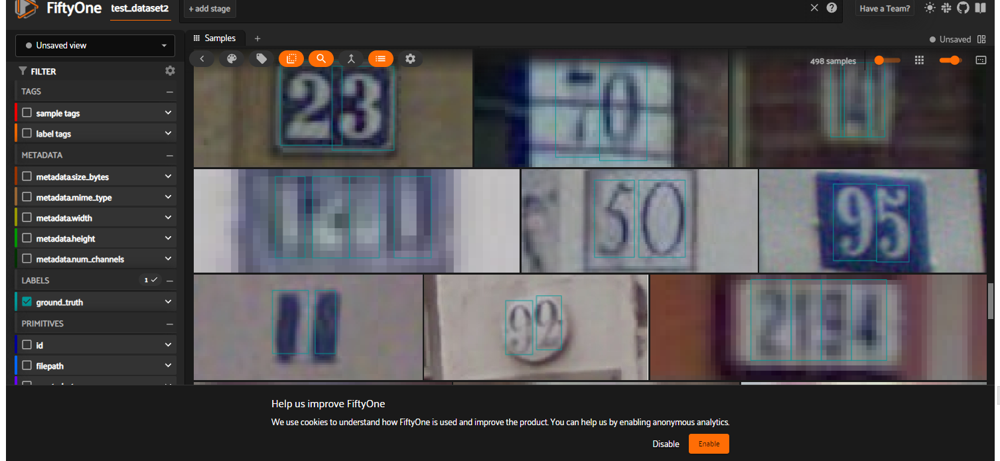

In [ ]:
ds_name = 'test_dataset3'

In [ ]:
dataset_test = fo.Dataset(ds_name)

In [ ]:
for split in splits:
    if split == 'test':
        dataset_test.add_dir(
            dataset_dir=dataset_dir,
            dataset_type=fo.types.YOLOv5Dataset,
            label_field='ground_truth',
            tags=split,
            split=split,
        )

 100% |█████████████| 13068/13068 [36.4s elapsed, 0s remaining, 496.9 samples/s]      


INFO:eta.core.utils: 100% |█████████████| 13068/13068 [36.4s elapsed, 0s remaining, 496.9 samples/s]      


In [ ]:
session3=fo.launch_app(dataset_test)

In [ ]:
classes = '/content/drive/MyDrive/classes.txt'

- Визуализация предсказаний на test выборке

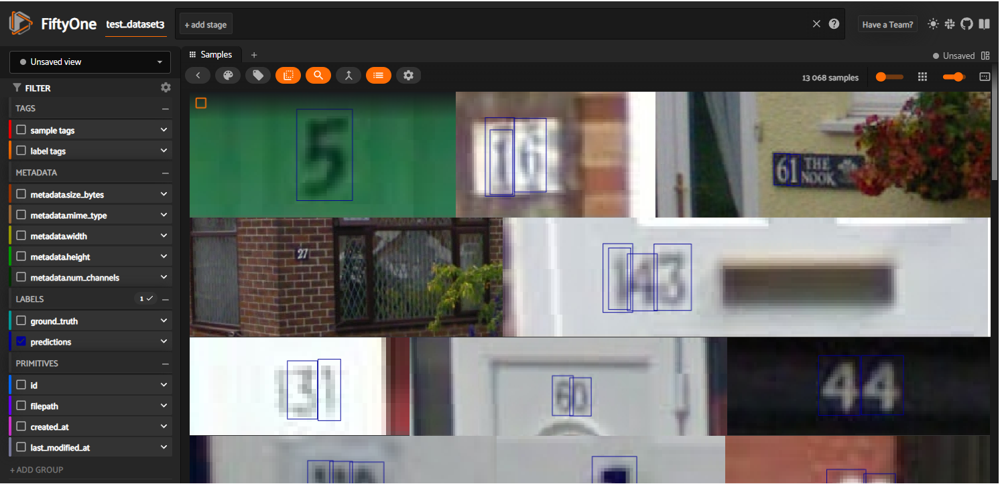

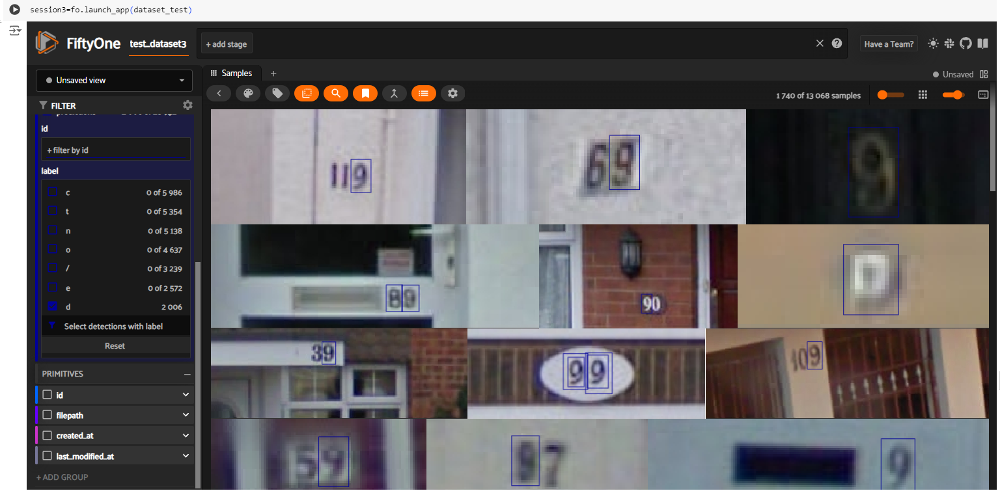

- заметим, модель предсказала суммарно 7 классов, а должно быть 10

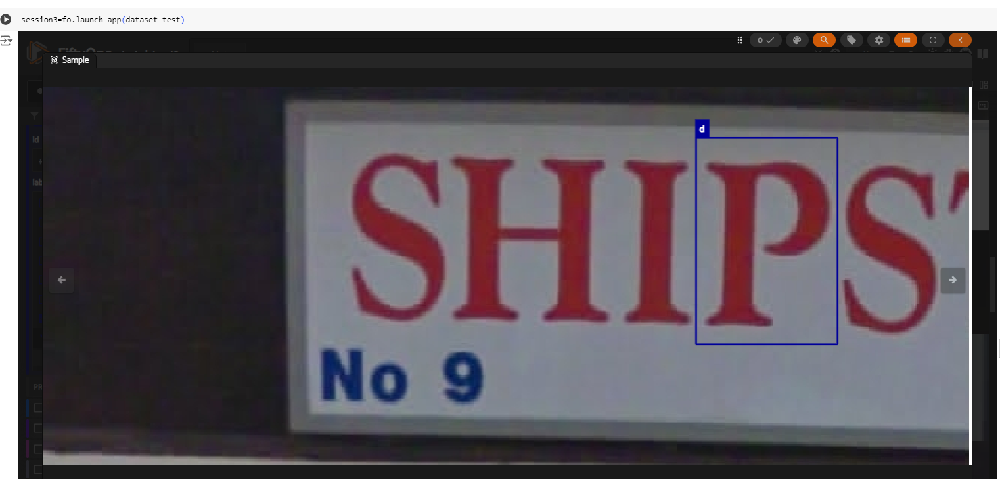

- Заметим, что модель так же допускает ошибки

In [ ]:
fouy.add_yolo_labels(sample_collection=dataset_test, label_field='predictions', labels_path=predictions_dir, classes=classes)

In [ ]:
session3.refresh()

In [ ]:
session3 = session3.freeze()

# Инференс модели с OpenCV

In [ ]:
import cv2
import matplotlib.pyplot as plt

In [ ]:
# Преобразование координат YOLO в реальные координаты для отображения на изображении.
def yolo_to_bbox(yolo_box, img_width, img_height):
    x_center, y_center, width, height = yolo_box

    # Преобразование в пиксели
    x_center *= img_width
    y_center *= img_height
    width *= img_width
    height *= img_height

    # Вычисление углов
    x_min = int(x_center - width / 2)
    y_min = int(y_center - height / 2)
    x_max = int(x_center + width / 2)
    y_max = int(y_center + height / 2)

    return [x_min, y_min, x_max, y_max]

In [ ]:
# Отображение изображения с bounding boxes из файла YOLO меток.
def draw_bboxes(image_path, label_path):
    # Чтение изображения
    image = cv2.imread(image_path)
    img_height, img_width, _ = image.shape

    # Чтение файла меток
    with open(label_path, 'r') as f:
        lines = f.readlines()

# Обработка каждой строки в файле меток
    for line in lines:
        class_id, x_center, y_center, width, height = map(float, line.strip().split())

        # Преобразование координат YOLO в реальные координаты для изображения
        bbox = yolo_to_bbox([x_center, y_center, width, height], img_width, img_height)

        # Отрисовка прямоугольника (bounding box) на изображении
        x_min, y_min, x_max, y_max = bbox
        color = (0, 255, 0)  # Зеленый цвет для рамки
        thickness = 2        # Толщина линии
        image = cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, thickness)

        # Можно также отобразить class_id рядом с боксом
        cv2.putText(image, str(int(class_id)), (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    # Конвертируем изображение из BGR в RGB для корректного отображения в matplotlib
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Отображение изображения с bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

In [ ]:
image_path = "/content/images/test/99.png"
label_path = "/content/runs/train/yolov5n_exp12/labels/99.txt"

2


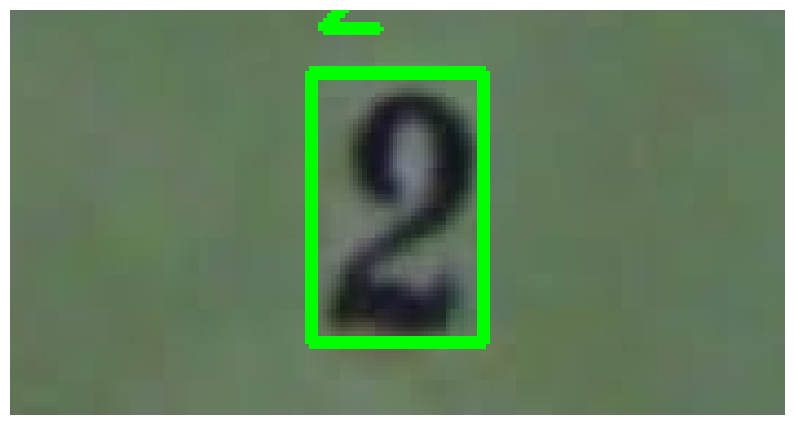

In [ ]:

with open('/content/runs/train/yolov5n_exp12/labels/99.txt') as f:

    lines = np.array([line.rstrip() for line in f])
    for line in lines:
      print(line[0])

draw_bboxes(image_path, label_path)

# Итог

Мы обучили модель YOLO5nu детектировать и классифицировать цифры на изорбражении. В процессе визуализации в FiftyOne предсказаний на тестовой выборке заметил, что модель классифицировала всего 7 классов из 10 имеющихся, при этом на validarion выборке модель детектировала все цифры. Возможно необходимо заново обучить модель используя в val выборке 1000 картинок, количество эпох увеличить до 10.